# Loading previously generated and pickled SHAP values and performing analysis and visualization on them

This notebook demonstrates different visualizations of the SHAP package. The data consist of pre-generated SHAP values for the test set predictions of the ECCO-BERT-Seq model. The generation batch scripts **SHAP_batch_run.sh** (for running the job on Puhti SLURM system) and **SHAP_batch.py** are in this same folder.

## Imports

In [ ]:
# Rough and ready install
#!pip install shap

In [1]:
import pandas as pd
import torch
import numpy as np
import shap

## Reading the genres and subgenres from a file

In [2]:
import ecco_helper
genres = ecco_helper.get_genres()
genres

['Arts',
 'Scientific Improvement',
 'Literature',
 'Education',
 'History',
 'Law',
 'Sales Catalogues',
 'Politics',
 'Philosophy',
 'Religion']

## Loading the SHAP values (for the whole test set)

Values have been generated by SHAP_batch.py.

In [3]:
import pickle
pickle_file = "data/ecco_bert_seq_test_shap_values.pickle"
loaded_shap_values = pickle.load(open(pickle_file, 'rb'))

### Get the (first) text chunks for the test set documents


In [4]:
doc_ids, genre_ids, genre_labels, texts  = ecco_helper.ecco_test_texts_as_list() # reads the test set chunks from a file and returns a list
# Print the first text chunk of the first document and its genre
for i in range(10): # list the first 10 docs
    print(f"{doc_ids[i]:<10} {genre_ids[i]} {genre_labels[i]:20} {texts[i][:130]}")

372500103  7 Politics             A COLLECTION OF THE PARLIAMENTARY DEB ATE I N ENG LAND , FROM The YEAR M , DC , LXVIII . To the present T I M E . V O L III . Prin
55103900   0 Arts                 SCQOOL FOR SCA , AL , ¼ y A CO ME D Y AS IT IS PERFORMED AT THE T H £ E A T ER R 0A L IN CR O W S T R E T . THE FOURTH EDITION . I
708900201  3 Education            LETTERS WRITTEN BY THE LATE RIGHT HONOURABLE PHIL IP DORM ZR STs JHOPE EARL OF CHESTERFIELD , TO 1 IIS SON , PHILIP S ANHOE , ESZ 
562301400  0 Arts                 L E T H E . Written by DAVID GARRICK , EsQ . DRAMATIS PERSONA . iEsor Old Man . MERcul y Mr TATOO . CHAO ON Poet . LoRD CHALCSTONo
73102301   4 History              TH HISTORY 0 F Sir Charles Grandifon . I N SEVEN VOLUMES . A ADVERTISEMENT . O apology can be wanting for uflering into the world 
411801000  8 Philosophy           ½ P . oper to Be observed on tile g 1 1K jN Lr t E nnrted for A , MILLA in the Stand . MDCCLXII , c Prg e x P o v ¥ a V f5 s 4 i A
677100806 

# Different kinds of SHAP visualizations

See (https://shap.readthedocs.io/en/latest/example_notebooks/api_examples/plots/text.html)

## SHAP force plots (for the first two documents of those listed above)

In [ ]:
import shap
shap.plots.text(loaded_shap_values[:2])


### Force plots for a specific class

In [6]:
shap.plots.text(loaded_shap_values[:2, :, "Politics"])

## Saving a SHAP plot
### As html

In [7]:
file = open('temp.html','w')
file.write(shap.plots.text(loaded_shap_values[0], display=False))
file.close

<function TextIOWrapper.close()>

### As png (doesn't seem to work with interactive plots (shap.

In [ ]:
import matplotlib.pyplot as plt
shap.plots.bar(loaded_shap_values[:,:,"Politics"].abs.mean(0), order=shap.Explanation.argsort.flip, show=False)
plt.savefig('shap_bar_plot1.png', bbox_inches='tight')

## Bar plots 
### Plotting the top words impacting a specific class (global explanation=all texts in the test set)

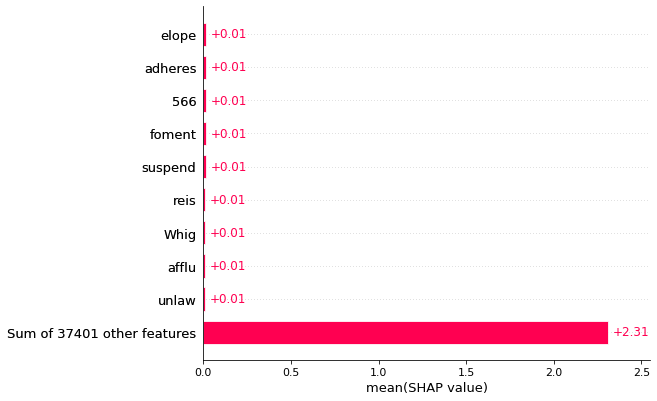

In [10]:
shap.plots.bar(loaded_shap_values[:,:,"Politics"].mean(0), order=shap.Explanation.argsort.flip)

### Explain the prediction of a specific class on the first sample

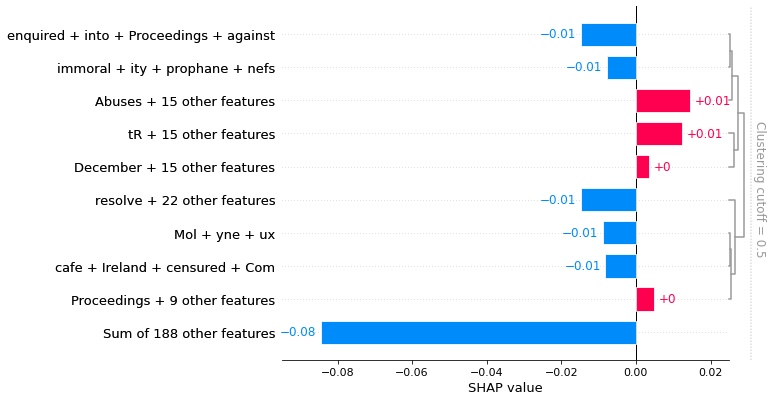

In [11]:
shap.plots.bar(loaded_shap_values[0,:,"Law"])

## Waterfall plots
A waterfall plot shows how incrementally adding shap values to base value generates the prediction probability. Below, we have created a waterfall chart for the 1st sample. It shows how shap values of words contributed to the base value to come to the final prediction probability.

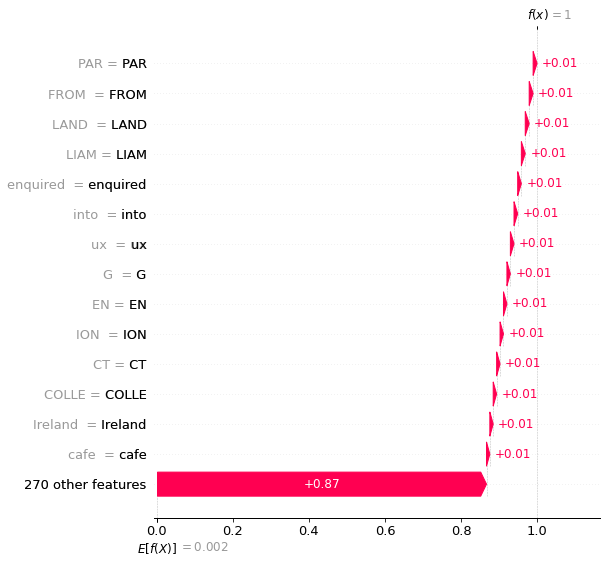

In [12]:
shap.waterfall_plot(loaded_shap_values[0][:, "Politics"], max_display=15)